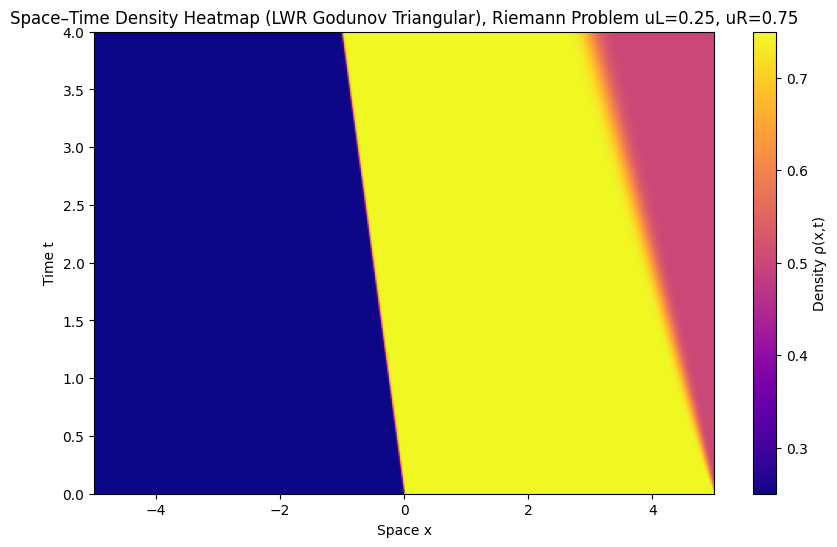

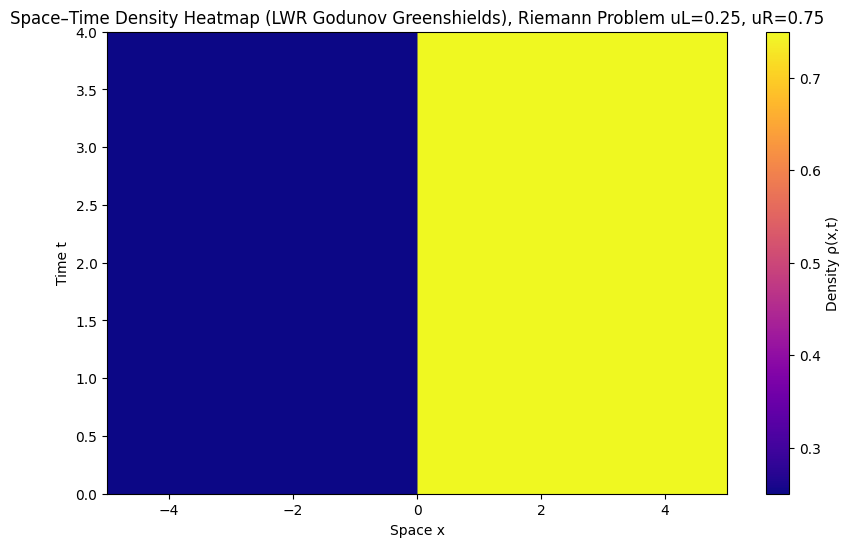

In [ ]:
# LWR Model Solver using Godunov's Method

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter
from IPython.display import HTML

# fundamental diagrams
def greenshields_flux(rho, vmax=1.0, rho_max=1.0):
    """Quadratic Greenshields flux f(rho) = vmax * rho * (1 - rho/rho_max)."""
    return vmax * rho * (1 - rho / rho_max)

def greenshields_df_drho(rho, vmax=1.0, rho_max=1.0):
    return vmax * (1 - 2*rho / rho_max)

def triangular_flux(rho, v_f=1.0, w=0.5, rho_max=1.0):
    """Triangular FD: f(rho) = min(v_f * rho, w * (rho_max - rho))"""
    return np.minimum(v_f * rho, w * (rho_max - rho))

def triangular_df_drho_piecewise(rho, v_f=1.0, w=0.5, rho_max=1.0):
    """f'(rho) piecewise for triangular (left slope v_f, right slope -w)."""
    rho_c = (w/(v_f + w)) * rho_max
    return np.where(rho <= rho_c, v_f, -w)

# Godunov flux (scalar)
def godunov_flux_scalar(rhoL, rhoR, flux_fn, rho_max=None):
    # make arrays
    rhoL = np.asarray(rhoL)
    rhoR = np.asarray(rhoR)
    fL = flux_fn(rhoL)
    fR = flux_fn(rhoR)

    flux = np.empty_like(fL)

    # rhoL <= rhoR (rarefaction)
    mask_lr = (rhoL <= rhoR)
    if np.any(mask_lr):
        flux[mask_lr] = np.minimum(fL[mask_lr], fR[mask_lr])

    # rhoL > rhoR (shock)
    mask_rl = ~mask_lr
    if np.any(mask_rl):
        flux[mask_rl] = np.maximum(fL[mask_rl], fR[mask_rl])

    return flux

def godunov_flux_triangular(rhoL, rhoR, v_f=1.0, w=0.5, rho_max=1.0):
    """
    Godunov flux for triangular fd
    """
    rho_c = (w/(v_f + w)) * rho_max
    q_max = v_f * rho_c

    rhoL = np.asarray(rhoL)
    rhoR = np.asarray(rhoR)
    fL = triangular_flux(rhoL, v_f, w, rho_max)
    fR = triangular_flux(rhoR, v_f, w, rho_max)
    flux = np.empty_like(fL)

    # rarefaction (rhoL <= rhoR)
    mask_lr = (rhoL <= rhoR)
    if np.any(mask_lr):
        flux[mask_lr] = np.minimum(fL[mask_lr], fR[mask_lr])

    # shock (rhoL > rhoR)
    mask_rl = ~mask_lr
    if np.any(mask_rl):
        flux[mask_rl] = np.maximum(fL[mask_rl], fR[mask_rl])

    return flux

# FVM Godunov solver
def lwr_godunov(rho0, x, t_final, flux_type='triangular', params=None, CFL=0.9, periodic=True):
    """
    rho0: initial density array (cells) length N
    x: cell-center coordinates length N
    t_final: final time
    flux_type: 'triangular' or 'greenshields' or 'custom'
    params: dict of parameters for flux (v_f,w,rho_max) or (vmax,rho_max)
    returns: snapshots list (rho at stored times), times list
    """
    N = len(rho0)
    dx = x[1] - x[0]

    # choose flux
    if flux_type == 'triangular':
        v_f = params.get('v_f', 1.0)
        w = params.get('w', 0.5)
        rho_max = params.get('rho_max', 1.0)
        flux_fn = lambda r: triangular_flux(r, v_f, w, rho_max)
        df_fn = lambda r: triangular_df_drho_piecewise(r, v_f, w, rho_max)
        god_flux = lambda L,R: godunov_flux_triangular(L,R,v_f,w,rho_max)
    elif flux_type == 'greenshields':
        v_max = params.get('v_max', 1.0)
        rho_max = params.get('rho_max', 1.0)
        flux_fn = lambda r: greenshields_flux(r, v_max, rho_max)
        df_fn = lambda r: greenshields_df_drho(r, v_max, rho_max)
        god_flux = lambda L,R: godunov_flux_scalar(L,R,flux_fn)
    else:
        raise ValueError("flux_type must be 'triangular' or 'greenshields'")

    rho = rho0.copy()
    t = 0.0
    snapshots = [rho.copy()]
    times = [t]

    # timestep loop
    while t < t_final - 1e-12:
        if flux_type == 'triangular':
            max_char = max(abs(v_f), abs(w))
        else:
            max_char = np.max(np.abs(df_fn(rho)))
        dt = CFL * dx / (max_char + 1e-14)
        if t + dt > t_final:
            dt = t_final - t

        rhoL = rho.copy()
        rhoR = np.roll(rho, -1)
        Fh = god_flux(rhoL, rhoR)  # array length N, Fh[i] is flux at i+1/2

        # flux divergence
        # F_{i+1/2} - F_{i-1/2}; note Fh[i] = F_{i+1/2}, and Fh[i-1] = F_{i-1/2}
        divF = (Fh - np.roll(Fh, 1)) / dx

        rho = rho - dt * divF

        # physical bounds
        rho = np.clip(rho, 0.0, rho_max)

        t += dt
        snapshots.append(rho.copy())
        times.append(t)

    return np.array(snapshots), np.array(times), x

# Evaluate with Riemann problem
if __name__ == "__main__":
    # grid
    N_x = 400
    xL, xR = -5.0, 5.0
    x = np.linspace(xL, xR, N_x, endpoint=False)
    dx = x[1] - x[0]

    # initial Riemann: left high density, right low density
    rhoL = 0.25
    rhoR = 0.75
    rho0 = np.where(x < 0.0, rhoL, rhoR)

    # flux params (triangular recommended)
    params = dict(v_f=1.0, w=0.5, rho_max=1.0)

    # run
    t_final = 4.0
    snapsT, timesT, xT = lwr_godunov(rho0, x, t_final, flux_type='triangular', params=params, CFL=0.9)
    snapsG, timesG, xG = lwr_godunov(rho0, x, t_final, flux_type='greenshields', params=params, CFL=0.9)

## Space–time density heatmaps
# Triangular FD results
plt.figure(figsize=(10, 6))

plt.imshow(
    snapsT, 
    extent=[xL, xR, timesT[0], timesT[-1]],
    aspect='auto',
    origin='lower',
    cmap='plasma'
)

plt.colorbar(label='Density ρ(x,t)')
plt.xlabel('Space x')
plt.ylabel('Time t')
plt.title('Space–Time Density Heatmap (LWR Godunov Triangular), Riemann Problem uL=' + str(rhoL) + ', uR=' + str(rhoR))
plt.show()

# Greenshields FD results
plt.figure(figsize=(10, 6))

plt.imshow(
    snapsG, 
    extent=[xL, xR, timesG[0], timesG[-1]],
    aspect='auto',
    origin='lower',
    cmap='plasma'
)

plt.colorbar(label='Density ρ(x,t)')
plt.xlabel('Space x')
plt.ylabel('Time t')
plt.title('Space–Time Density Heatmap (LWR Godunov Greenshields), Riemann Problem uL=' + str(rhoL) + ', uR=' + str(rhoR))
plt.show()


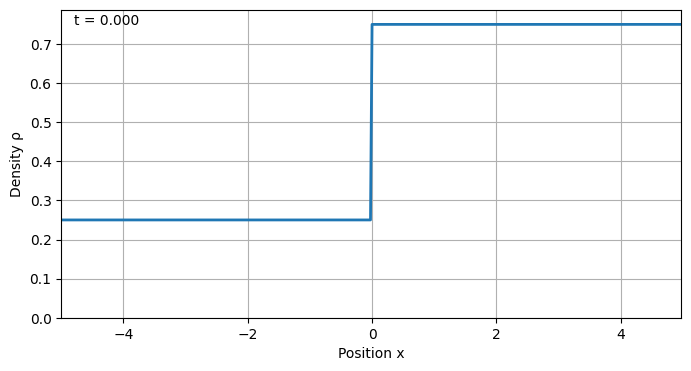

In [18]:
# Animate Greenshields FD results
fig, ax = plt.subplots(figsize=(8,4))
line, = ax.plot(x, snapsG[0], lw=2)
ax.set_xlim(x.min(), x.max())
ax.set_ylim(0, np.max(snapsG)*1.05)
ax.set_xlabel('Position x')
ax.set_ylabel('Density ρ')
ax.grid(True)
title = ax.text(0.02, 0.95, '', transform=ax.transAxes)

def update(frame):
    line.set_ydata(snapsG[frame])
    title.set_text(f't = {timesG[frame]:.3f}')
    return line, title

from matplotlib.animation import FuncAnimation
anim = FuncAnimation(fig, update, frames=len(snapsG), interval=40)

# Display animation in Jupyter
from IPython.display import HTML
HTML(anim.to_jshtml())

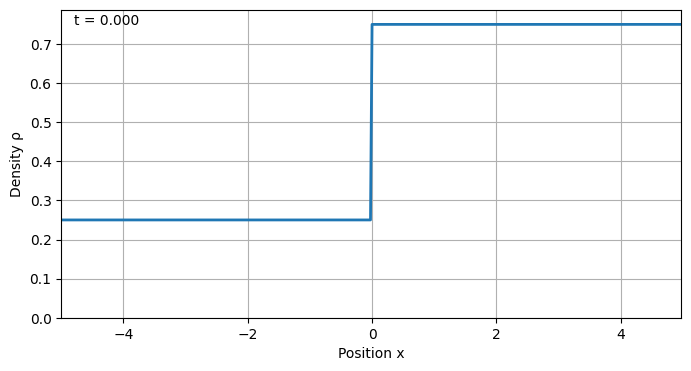

In [19]:
# Animate Triangular FD results
fig, ax = plt.subplots(figsize=(8,4))
line, = ax.plot(x, snapsT[0], lw=2)
ax.set_xlim(x.min(), x.max())
ax.set_ylim(0, np.max(snapsT)*1.05)
ax.set_xlabel('Position x')
ax.set_ylabel('Density ρ')
ax.grid(True)
title = ax.text(0.02, 0.95, '', transform=ax.transAxes)

def update(frame):
    line.set_ydata(snapsT[frame])
    title.set_text(f't = {timesT[frame]:.3f}')
    return line, title

from matplotlib.animation import FuncAnimation
anim = FuncAnimation(fig, update, frames=len(snapsT), interval=40)

# Display animation in Jupyter
from IPython.display import HTML
HTML(anim.to_jshtml())


Collected 101 snapshots up to t = 2.0


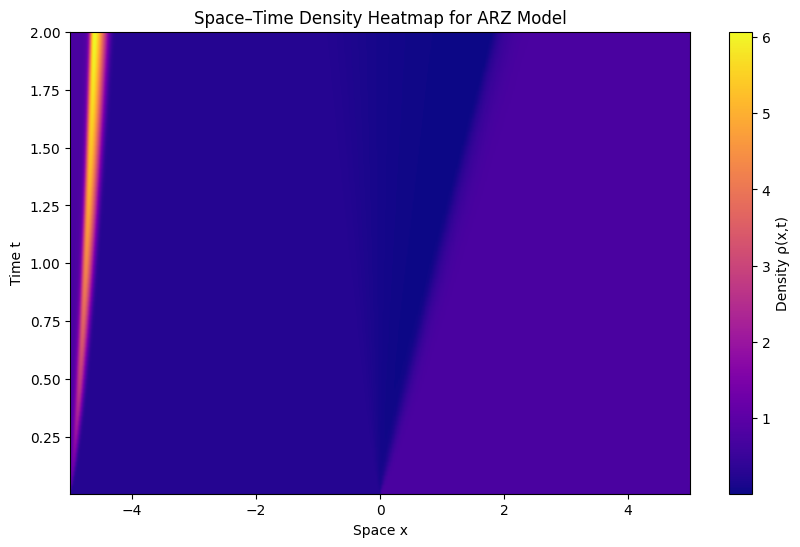

In [ ]:
# ARZ Model Solver using Rusanov's Method

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

a = 0.36            # pressure amplitude (p(rho) = a * log(rho + eps))
eps = 1e-8          # small regularizer to avoid log(0)
CFL = 0.45          # CFL number for stability
xL, xR = -5.0, 5.0
N = 600             # number of cells
t_final = 2.0       # final time
snap_dt = 0.02      # store snapshot every snap_dt seconds for animation

# Pressure law and helpers
def p_of_rho(rho):
    return a * np.log(rho + eps)

def dp_drho(rho):
    return a / (rho + eps)

# U = [rho, q], q = rho * w = rho * (v + p(rho))
def prim_from_U(U):
    rho = U[0]
    q = U[1]
    rho_safe = np.maximum(rho, 1e-12) # no divison by zero
    w = q / rho_safe # w = v + p
    v = w - p_of_rho(rho)
    return rho, v, w

def flux_from_U(U):
    rho, v, w = prim_from_U(U)
    F1 = rho * v
    F2 = rho * v * w
    return np.vstack([F1, F2]) # shape (2, N)

# Rusanov numerical flux
def rusanov_flux(UL, UR):
    """
    UL, UR: arrays shape (2,) or (2, M) for vectorized interface evaluation.
    Returns flux array shape (2,) or (2, M).
    """
    FL = flux_from_U(UL)
    FR = flux_from_U(UR)

    # compute maximum absolute eigenvalue (wave speed) at interface
    # ARZ: eigenvalues are lambda1 = v, lambda2 = v + rho * p'(rho)
    rhoL, vL, _ = prim_from_U(UL)
    rhoR, vR, _ = prim_from_U(UR)
    lam1_L = vL
    lam2_L = vL + rhoL * dp_drho(rhoL)
    lam1_R = vR
    lam2_R = vR + rhoR * dp_drho(rhoR)

    alpha = np.maximum.reduce([np.abs(lam1_L), np.abs(lam2_L), np.abs(lam1_R), np.abs(lam2_R)])
    return 0.5*(FL + FR) - 0.5 * alpha * (UR - UL)

# RHS and time integrator (SSP RK2)
def compute_rhs(U, dx):
    _, N = U.shape
    # compute numerical fluxes at interfaces i+1/2 for i=0..N-1
    UL = U.copy()
    UR = np.roll(U, -1, axis=1)
    Fh = rusanov_flux(UL, UR)   # shape (2,N)
    # flux divergence: (F_{i+1/2} - F_{i-1/2}) / dx
    div = (Fh - np.roll(Fh, 1, axis=1)) / dx
    return -div

def ssp_rk2_step(U, dt, dx):
    k1 = compute_rhs(U, dx)
    U1 = U + dt * k1
    k2 = compute_rhs(U1, dx)
    Unew = 0.5*(U + U1 + dt * k2)
    return Unew

# Riemann like Initial condition
def initial_riemann(x, x0=0.0, rhoL=1.0, vL=0.0, rhoR=0.2, vR=0.0):
    rho = np.where(x < x0, rhoL, rhoR)
    v   = np.where(x < x0, vL, vR)
    q = rho * (v + p_of_rho(rho))
    return rho, v, q

# Evaluate with Riemann problem
# grid
x = np.linspace(xL, xR, N, endpoint=False)
dx = x[1] - x[0]

# initial state
rhoL, vL = 0.25, 0.0
rhoR, vR = 0.75, 1.0
rho0, v0, q0 = initial_riemann(x, x0=0.0, rhoL=rhoL, vL=vL, rhoR=rhoR, vR=vR)
U = np.vstack([rho0.copy(), q0.copy()])   # shape (2,N)

t = 0.0
snapshots_rho = []
snapshots_v = []
times = []

next_snap = 0.0

# time loop
while t < t_final - 1e-12:
    # compute max wave speed for CFL
    rho_vals, v_vals, _ = prim_from_U(U)
    lam1 = v_vals
    lam2 = v_vals + rho_vals * dp_drho(rho_vals)
    max_alpha = np.max(np.abs(np.vstack([lam1, lam2])))
    dt = CFL * dx / (max_alpha + 1e-12)
    if t + dt > t_final:
        dt = t_final - t

    U = ssp_rk2_step(U, dt, dx)
    t += dt

    # store snapshots at roughly uniform time spacing
    if t >= next_snap - 1e-12 or t >= t_final - 1e-12:
        rho_vals, v_vals, _ = prim_from_U(U)
        snapshots_rho.append(rho_vals.copy())
        snapshots_v.append(v_vals.copy())
        times.append(t)
        next_snap += snap_dt

snapshots_rho = np.array(snapshots_rho)  # shape (nt, N)
snapshots_v   = np.array(snapshots_v)
times = np.array(times)

print("Collected", snapshots_rho.shape[0], "snapshots up to t =", times[-1])

# ARZ model results - Space–time density heatmap
plt.figure(figsize=(10, 6))

plt.imshow(snapshots_rho, extent=[xL, xR, times[0], times[-1]], aspect='auto', origin='lower', cmap='plasma') #cmap='viridis'

plt.colorbar(label='Density ρ(x,t)')
plt.xlabel('Space x')
plt.ylabel('Time t')
plt.title('Space–Time Density Heatmap for ARZ Model')
plt.show()

In [ ]:
# Animate ARZ results
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(12,4))
line_rho, = ax1.plot(x, snapshots_rho[0], lw=2)
ax1.set_xlim(xL, xR)
ax1.set_ylim(0.0, np.max(snapshots_rho)*1.1)
ax1.set_xlabel('x'); ax1.set_ylabel(r'$\rho(x,t)$'); ax1.grid(True)

line_v, = ax2.plot(x, snapshots_v[0], lw=2)
ax2.set_xlim(xL, xR)
ax2.set_ylim(np.min(snapshots_v)*1.1, np.max(snapshots_v)*1.1)
ax2.set_xlabel('x'); ax2.set_ylabel('v(x,t)'); ax2.grid(True)

title = fig.suptitle("")

def update(frame):
    line_rho.set_ydata(snapshots_rho[frame])
    line_v.set_ydata(snapshots_v[frame])
    title.set_text(f"t = {times[frame]:.3f}")
    return line_rho, line_v, title

anim = FuncAnimation(fig, update, frames=len(times), interval=60, blit=True)

# Save as GIF
writer = PillowWriter(fps=30)
anim.save("arz.gif", writer=writer)

plt.close(fig)

# display inline in Jupyter
HTML(anim.to_jshtml())

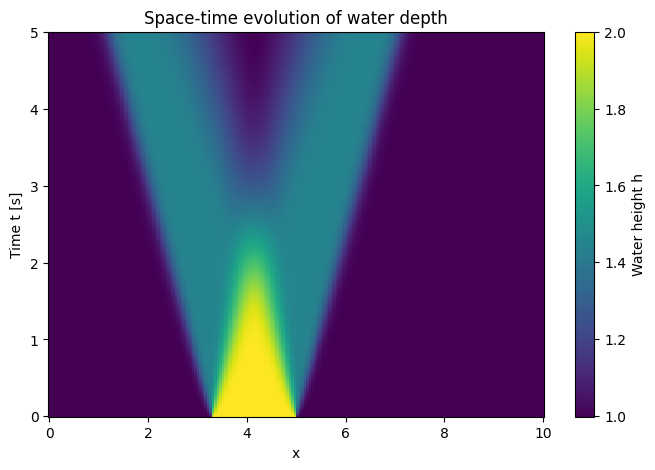

In [ ]:
# 1D SV with Godunov's Method

g = 9.81
L = 10.0
nx = 200
dx = L / nx
CFL = 0.1
t_final = 5.0

# initial conditions
#h = np.sin(np.linspace(0, 2 * np.pi, 200)) + 1.5
h = np.ones(nx)
h[int(nx/3):int(nx/2)] = 2.0  # hump in the middle
u = np.zeros(nx)

# conserved variables: U = [h, hu]
U = np.zeros((nx, 2))
U[:,0] = h
U[:,1] = h * u

# flux function using HLL
def hll_flux(UL, UR):
    hL, huL = UL
    hR, huR = UR
    uL = huL/hL if hL>0 else 0
    uR = huR/hR if hR>0 else 0
    cL = np.sqrt(g*hL)
    cR = np.sqrt(g*hR)
    SL = min(uL - cL, uR - cR)
    SR = max(uL + cL, uR + cR)
    
    FL = np.array([huL, huL*uL + 0.5*g*hL**2])
    FR = np.array([huR, huR*uR + 0.5*g*hR**2])
    
    if SL >= 0:
        return FL
    elif SR <= 0:
        return FR
    else:
        return (SR*FL - SL*FR + SL*SR*(UR - UL)) / (SR - SL)

dt_record = 0.01
nt = int(t_final/dt_record) + 1
h_record = np.zeros((nt, nx))

t = 0.0
step = 0
while t < t_final:
    h = U[:,0]
    u = np.where(h>0, U[:,1]/h, 0)
    dt = CFL * dx / np.max(np.abs(u) + np.sqrt(g*h))
    if t + dt > t_final:
        dt = t_final - t
    n_substeps = max(1, int(np.ceil(dt/dt_record)))
    dt_sub = dt / n_substeps
    
    for _ in range(n_substeps):
        U_new = U.copy()
        for i in range(1, nx-1):
            UL = U[i-1]
            UR = U[i]
            F_left = hll_flux(UL, UR)
            
            UL = U[i]
            UR = U[i+1]
            F_right = hll_flux(UL, UR)
            
            U_new[i] = U[i] - dt_sub/dx * (F_right - F_left)
        U = U_new
        t += dt_sub
        
        if step < nt:
            h_record[step,:] = U[:,0]
            step += 1

# plot space-time heatmap
x = np.linspace(0, L, nx)
t_axis = np.linspace(0, t_final, nt)

plt.figure(figsize=(8,5))
plt.pcolormesh(x, t_axis, h_record, shading='auto', cmap='viridis')
plt.colorbar(label='Water height h')
plt.xlabel('x')
plt.ylabel('Time t [s]')
plt.title('Space-time evolution of water depth')
plt.show()

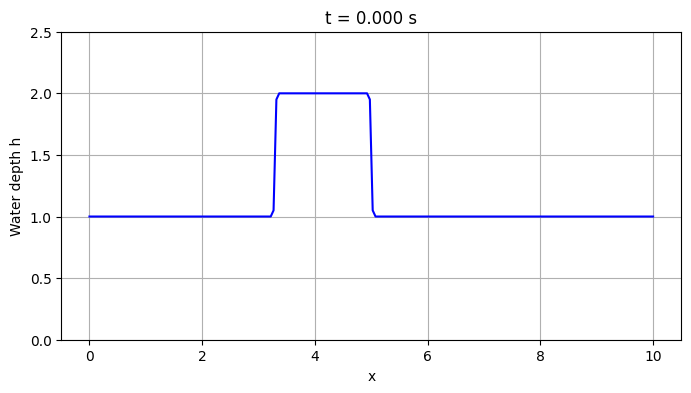

In [47]:
# Animate 1D SV Results

x = np.linspace(0, L, nx)
fig, ax = plt.subplots(figsize=(8,4))
line, = ax.plot(x, h_record[0,:], color='b')
ax.set_ylim(0, 2.5)
ax.set_xlabel("x")
ax.set_ylabel("Water depth h")
ax.set_title("Shallow water evolution")
ax.grid(True)

def animate(frame):
    line.set_ydata(h_record[frame,:])
    ax.set_title(f"t = {frame*dt_record:.3f} s")
    return line,

ani = FuncAnimation(fig, animate, frames=nt, interval=20, blit=False)

# Save as GIF
writer = PillowWriter(fps=30)
ani.save("1d_sv.gif", writer=writer)

# Display in notebook
HTML(ani.to_jshtml())